In [1]:
import caffe
import numpy as np
from matplotlib import pylab as pl
import os
import cv2
import sys
import time
import anno_func, json
import commands as cmd
import random
import copy
%matplotlib inline

In [2]:
datadir = ".."

filedir = datadir + "/annotations.json"
ids = open(datadir + "/test/ids.txt").read().splitlines()

annos = json.loads(open(filedir).read())

In [33]:
#result_anno_file = "../results/skynet_result_annos.json"
result_anno_file = "/home/randon/tmp/older_result_annos.json"
#result_anno_file = "/home/randon/tmp/skynet45_result_annos.json"

results_annos2 = json.loads(open(result_anno_file).read())
print len(results_annos2['imgs'])
sm = anno_func.eval_annos(annos, results_annos2, iou=0.5, types=anno_func.type45, check_type=True)
print sm['report']

1741
iou:0.5, size:[0,400), types:[pl120, ...total 45...], accuracy:0.870561797753, recall:0.886904761905


In [3]:
reload(anno_func)
results_annos = json.loads(open("../results/berserker_result_annos.json").read())
print len(results_annos['imgs'])
sm = anno_func.eval_annos(annos, results_annos, iou=0.5, types=anno_func.type45, check_type=True, match_same=False)
print sm['report']
#sm = anno_func.eval_annos(annos, results_annos, iou=0.5, check_type=False)

3078
iou:0.5, size:[0,400), types:[pl120, ...total 45...], accuracy:0.877382146439, recall:0.906594118409


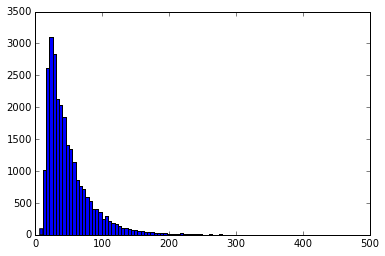

In [422]:
sizes = [ anno_func.box_long_size(obj['bbox']) for k,img in annos['imgs'].items() for obj in img['objects']]
_ = pl.hist(sizes, bins=100)

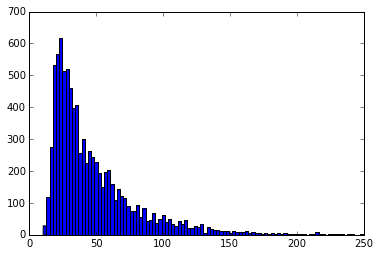

In [423]:
sizes = [ anno_func.box_long_size(obj['bbox']) for k,img in results_annos['imgs'].items() for obj in img['objects']]
_ = pl.hist(sizes, bins=100)

In [23]:
reload(anno_func)

#test_annos = res_annos2
#minscore=0.5
test_annos = results_annos2
minscore=40

sm = anno_func.eval_annos(annos, test_annos, iou=0.5, check_type=True, types=anno_func.type45,
                         minboxsize=0,maxboxsize=400,minscore=minscore)
print sm['report']
sm = anno_func.eval_annos(annos, test_annos, iou=0.5, check_type=True, types=anno_func.type45,
                         minboxsize=0,maxboxsize=32,minscore=minscore)
print sm['report']
sm = anno_func.eval_annos(annos, test_annos, iou=0.5, check_type=True, types=anno_func.type45,
                         minboxsize=32,maxboxsize=96,minscore=minscore)
print sm['report']
sm = anno_func.eval_annos(annos, test_annos, iou=0.5, check_type=True, types=anno_func.type45,
                         minboxsize=96,maxboxsize=400,minscore=minscore)
print sm['report']

for tp in anno_func.type45:
    sm = anno_func.eval_annos(annos, test_annos, iou=0.5, check_type=True, types=[tp],minscore=minscore)
    print sm['report']

iou:0.5, size:[0,400), types:[pl120, ...total 45...], accuracy:0.871824749476, recall:0.887123547546
iou:0.5, size:[0,32), types:[pl120, ...total 45...], accuracy:0.829652996845, recall:0.821361648969
iou:0.5, size:[32,96), types:[pl120, ...total 45...], accuracy:0.90474137931, recall:0.94041218638
iou:0.5, size:[96,400), types:[pl120, ...total 45...], accuracy:0.847150259067, recall:0.8515625
iou:0.5, size:[0,400), types:i2, accuracy:0.758241758242, recall:0.851851851852
iou:0.5, size:[0,400), types:i4, accuracy:0.859259259259, recall:0.928
iou:0.5, size:[0,400), types:i5, accuracy:0.944636678201, recall:0.947916666667
iou:0.5, size:[0,400), types:il100, accuracy:0.954545454545, recall:0.954545454545
iou:0.5, size:[0,400), types:il60, accuracy:0.950617283951, recall:0.875
iou:0.5, size:[0,400), types:il80, accuracy:0.877192982456, recall:0.925925925926
iou:0.5, size:[0,400), types:io, accuracy:0.763888888889, recall:0.852713178295
iou:0.5, size:[0,400), types:ip, accuracy:0.9014084507

99 1264.0 iou:0.5, size:[0,400), types:[pl120, ...total 45...], accuracy:1.0, recall:0.000232288037166


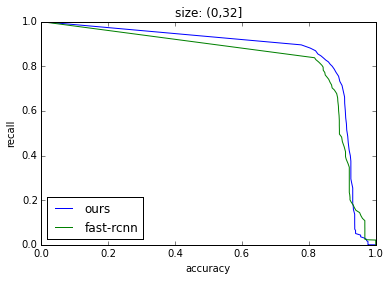

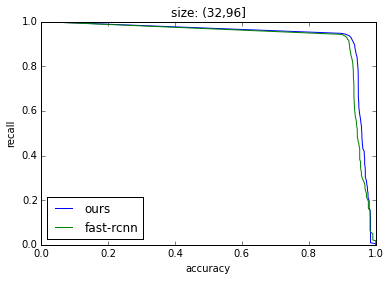

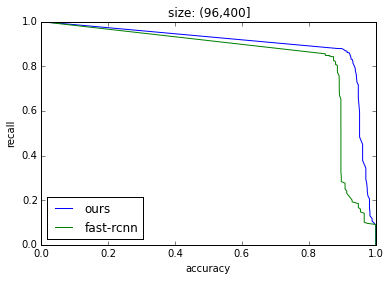

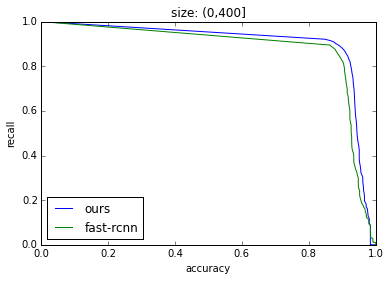

In [30]:
reload(anno_func)
def get_acc_res(results_annos, **argv):
    scs = [ obj['score'] for k,img in results_annos['imgs'].items() for obj in img['objects']]
    scs = sorted(scs)
    accs = [0]
    recs = [1]
    for i, score in enumerate(np.linspace(0, scs[-1], 100)):
        sm = anno_func.eval_annos(annos, results_annos, iou=0.5, check_type=True, types=anno_func.type45, minscore=score, **argv)
        print "\r%s %s %s" % (i, score, sm['report']), 
        sys.stdout.flush()
        accs.append(sm['accuracy'])
        if len(accs)>=2 and accs[-1]<accs[-2]:
            accs[-1] = accs[-2]
        recs.append(sm['recall'])
    accs.append(1)
    recs.append(0)
    return accs, recs
sizes = [0,32,96,400]
ac_rc = []

for i in range(4):
    if i==3:
        l=sizes[0]
        r=sizes[-1]
    else:
        l=sizes[i]
        r=sizes[i+1]
    acc1, recs1 = get_acc_res(results_annos, minboxsize=l, maxboxsize=r)
    acc2, recs2 = get_acc_res(results_annos2, minboxsize=l, maxboxsize=r)
    ac_rc.append([acc1, recs1, acc2, recs2])
    
    pl.figure()
    pl.plot(acc1, recs1, label='ours')
    pl.plot(acc2, recs2, label='fast-rcnn')
    pl.xlabel("accuracy")
    pl.ylabel("recall")
    pl.title("size: (%s,%s]"%(l,r))

    pl.legend(bbox_to_anchor=(0, 0), loc="lower left")
    #pl.savefig("/home/randon/data/newdata/results/ac-rc%s.pdf"%i)
#_ = pl.hist(scs, bins=100)

In [31]:
pl.rcParams.update({'font.size': 13})
pl.grid?

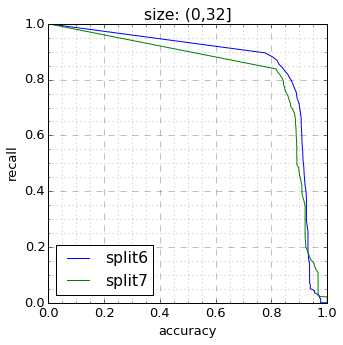

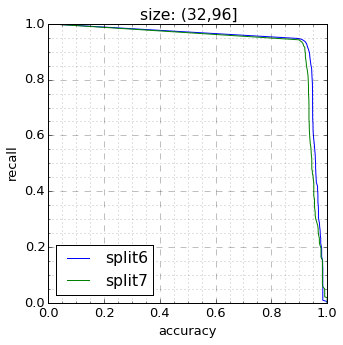

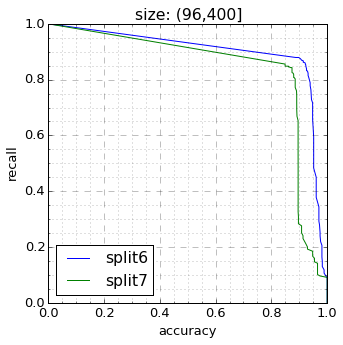

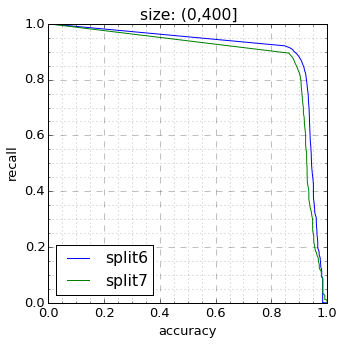

In [32]:
for i in range(4):
    if i==3:
        l=sizes[0]
        r=sizes[-1]
    else:
        l=sizes[i]
        r=sizes[i+1]
    acc1, recs1, acc2, recs2 = ac_rc[i]
    
    pl.figure(figsize=(5,5))
    pl.plot(acc1, recs1, label='split6')
    pl.plot(acc2, recs2, label='split7')
    pl.xlabel("accuracy")
    pl.ylabel("recall")
    pl.title("size: (%s,%s]"%(l,r))
    pl.tick_params(which='minor')
    pl.minorticks_on()
    #pl.grid(b=True, which='major', color='b', linestyle='-')
    #pl.grid(b=True, which='minor', color='b', linestyle='--')
    pl.grid(b=True, which='minor', alpha=0.5)
    pl.grid(b=True, which='major', alpha=0.5, linestyle='--')
    pl.axis([0,1,0,1])
    #pl.xticks(np.arange(0,1,0.1), rotation='vertical')
    #pl.yticks(np.arange(0,1,0.1))

    pl.legend(bbox_to_anchor=(0, 0), loc="lower left")
    pl.savefig("/home/randon/data/newdata/results/ac-rc-split%s.pdf"%i)

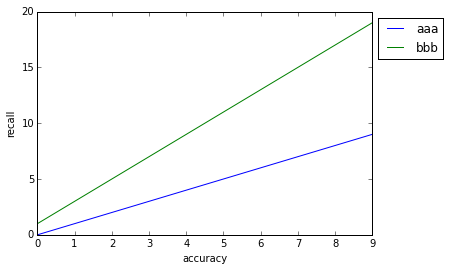

In [442]:
pl.plot(range(10), label="aaa")
pl.plot(range(1,20,2), label="bbb")
pl.legend(bbox_to_anchor=(1, 1), loc=2)
pl.xlabel("accuracy")
pl.ylabel("recall")

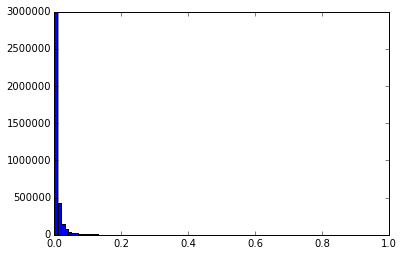

In [554]:
scs = [ obj['score'] for k,img in res_annos2['imgs'].items() for obj in img['objects']]
scs = sorted(scs)
_ = pl.hist(scs, bins=100)

In [411]:
sm = anno_func.eval_annos(annos, results_annos, iou=0.5, check_type=False, types=anno_func.type45)

iou:0.5, accuracy:0.89539181863, recall:0.943398675841


In [486]:
tmpannos = json.loads(open('/home/randon/tmp2/res2/res.json').read())

In [557]:
res_annos2 = {}
for i,(k,v) in enumerate(tmpannos.items()):
    #if i>100: break
    objs = []
    bboxs = []
    v = sorted(v, key=lambda x: -x['score'])
    for obj in v:
        rect = obj['bbox']
        area = 0.0
        #for box in bboxs:
        #    area += anno_func.calc_cover(box, rect)
        if obj['score'] < 0.05: continue
        if area <= 0.5:
            bboxs.append(rect)
            objs.append({
                    "bbox": dict(zip(['xmin','ymin','xmax','ymax'], rect)),
                    'score': obj['score'],
                    'category': obj['type']
                })
    res_annos2[k] = {"objects":objs}
    print i, k, len(bboxs)
    
res_annos2 = {"imgs": res_annos2}

0 10091010130304103209700.0 30
1 10091010130304151753100.2 55
2 10091010130304103334600.2 22
3 34031044141001105904300_back 9
4 10121010121104120531500_front 16
5 10091010130304105258200.2 64
6 10091010130304101308000.1 112
7 10091010130305123659100.2 28
8 10091010130305123659100.0 46
9 10091010130305123419800.2 23
10 10091010130304143639200.2 29
11 10011009130706104343300_left 82
12 10021007120612135239200_left 36
13 10091010130305140455600.1 9
14 10071003120930150933900_front 32
15 10091010130304105304000.3 7
16 32031048141111140830400_front 29
17 10091010130304102006000.1 57
18 10091010130304102006000.3 64
19 10091010130304102006000.2 30
20 10111033141120112114800_front 24
21 10021006120603104550300_front 29
22 18011027140702104201100_right 49
23 10061054141115141121200_front 16
24 10091010130305123404600.0 46
25 10011001140404145121800_front 36
26 10091010130304151304600.0 40
27 10091010130304102623500.2 20
28 10091010130304143300500.1 92
29 10021010130621113720000_right 85
30 1009

In [582]:
reload(anno_func)
sm = anno_func.eval_annos(annos, res_annos2, 0.5,  types=anno_func.type45, minscore=0.5)
print sm['report']
open("/home/randon/data/newdata/results/fastrcnn_result_annos.json", "w").write(json.dumps(res_annos2))
open("/home/randon/data/newdata/results/fastrcnn_result.json", "w").write(json.dumps(sm))

iou:0.5, size:[0,400), types:[pl120, ...total 45...], accuracy:0.501403508772, recall:0.555382821609


10091010130304103507900.3


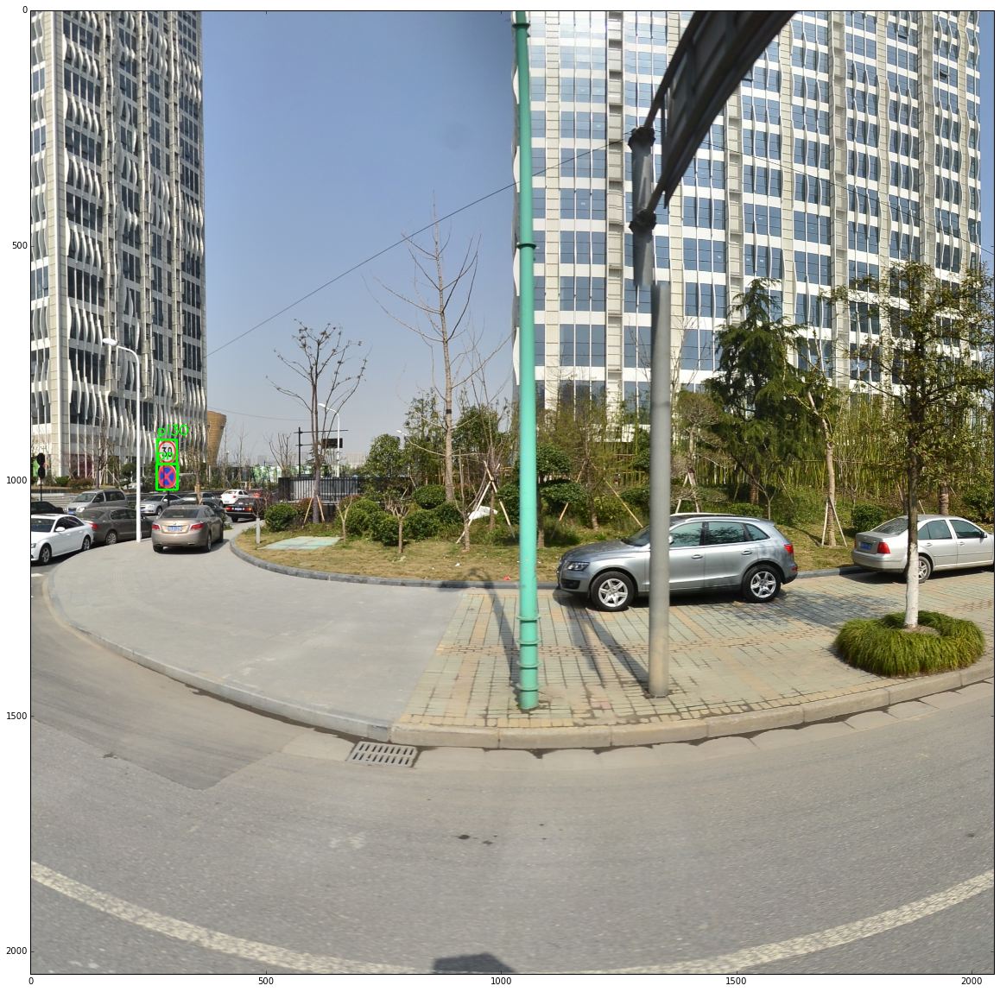

In [7]:
imgid = random.sample(results_annos['imgs'].keys(), 1)[0]
print imgid

imgdata = anno_func.load_img(annos, datadir, imgid)

imgdata = anno_func.draw_all(sm['right'], datadir, imgid, imgdata, (0,1,0), False)
imgdata = anno_func.draw_all(sm['wrong'], datadir, imgid, imgdata, (1,0,0), False)
imgdata = anno_func.draw_all(sm['miss'], datadir, imgid, imgdata, (0,0,1), False)

pl.figure(figsize=(20,20))
pl.imshow(imgdata)

In [382]:
while True:
    imgid = random.sample(results_annos['imgs'].keys(), 1)[0]
    if len(sm['wrong']["imgs"][imgid]["objects"]):
        break
    #if len(sm['miss']["imgs"][imgid]["objects"]):
    #    break
print imgid

10091010130304105654400.0


In [393]:
reload(anno_func)
total = 0
for imgid in results_annos['imgs'].keys()[:50]:
    imgdata = anno_func.load_img(annos, datadir, imgid)

    imgdata = anno_func.draw_all(sm['right'], datadir, imgid, imgdata, (0,1,0), False)
    imgdata = anno_func.draw_all(sm['wrong'], datadir, imgid, imgdata, (1,0,0), False)
    imgdata = anno_func.draw_all(sm['miss'], datadir, imgid, imgdata, (0,0,1), False)
    
    name = "/home/randon/tmp2/big/%s.png"%imgid
    print "save %s" % name
    pl.imsave(name, imgdata)

save /home/randon/tmp2/big/10021006120722141959200_back.png
save /home/randon/tmp2/big/10121010121104120531500_front.png
save /home/randon/tmp2/big/30011026130114153913200_front.png
save /home/randon/tmp2/big/10091010130304145710900.2.png
save /home/randon/tmp2/big/10091010130305124227400.1.png
save /home/randon/tmp2/big/10091010130305123659100.0.png
save /home/randon/tmp2/big/35011003130625150630700_front.png
save /home/randon/tmp2/big/10091010130304143651900.2.png
save /home/randon/tmp2/big/10091010130304103322800.0.png
save /home/randon/tmp2/big/10091010130304102006000.1.png
save /home/randon/tmp2/big/10081002130305145312400_front.png
save /home/randon/tmp2/big/10091010130305123020100.0.png
save /home/randon/tmp2/big/10091010130304102114500.2.png
save /home/randon/tmp2/big/10091010130304152232500.1.png
save /home/randon/tmp2/big/10091010130304101508300.0.png
save /home/randon/tmp2/big/18011027140702104201100_right.png
save /home/randon/tmp2/big/10061054141115141121200_front.png
save

In [9]:
reload(anno_func)
total = 0
num = 3000

outputdir = "/mnt/hd1/spm/tmp2/big/tmptask/"

have_big = True
several_type = True
have_small = False
is_save = True

def show_pic(img, path):
    global total
    total+=1
    if is_save:
        print '\r',"save",total, path,
        sys.stdout.flush()
        pl.imsave(path, img)
    else:
        pl.figure(figsize=(20,20))
        pl.imshow(img)
        pl.title(path)
        pl.show()

tid = [
    '10091010130304101622100.0',
    '10011007131016125135900_front',  
    '10111014141204114902500_left',  
    '10121019140707152244700_front',  '10091036130225150041500_front'
]
minscore=0
for minscore in [0,20,40]:
    sm = anno_func.eval_annos(annos, results_annos, iou=0.5, check_type=True, match_same=False, minscore=minscore)

    for imgid in tid:
        #if total > num:
        #    break
        imgdata = anno_func.load_img(annos, datadir, imgid)
        imgdata_org = imgdata.copy()

        imgdata = anno_func.draw_all(sm['right'], datadir, imgid, imgdata, (0,1,0), False)
        imgdata = anno_func.draw_all(sm['wrong'], datadir, imgid, imgdata, (1,0,0), False)
        imgdata = anno_func.draw_all(sm['miss'], datadir, imgid, imgdata, (0,0,1), False)

        imgdata_all = imgdata.copy()
        imgdata = imgdata_org.copy()

        imgdata = anno_func.draw_all(sm['right'], datadir, imgid, imgdata, (0,1,0), False, False)
        imgdata = anno_func.draw_all(sm['wrong'], datadir, imgid, imgdata, (1,0,0), False, False)
        imgdata = anno_func.draw_all(sm['miss'], datadir, imgid, imgdata, (0,0,1), False, False)
        imgdata_nolabel = imgdata.copy()
        #imgdata = anno_func.draw_all(annos, datadir, imgid, imgdata, (0,0,1), False)
        if have_big:
            show_pic(imgdata_all, outputdir+"%s_all_minscore_%s.png"%(imgid,minscore))
            if several_type:
                show_pic(imgdata_org, outputdir+"%s_origin_minscore_%s.png"%(imgid,minscore))
                show_pic(imgdata_nolabel, outputdir+"%s_nolabel_minscore_%s.png"%(imgid,minscore))

        if not have_small: continue

        #pl.figure(figsize=(20,20))
        #pl.imshow(imgdata)

        rboxs = []

        xlen = 640
        ylen = 480

        for anno in [sm['right'],sm['wrong'],sm['miss']]:
            for obj in anno['imgs'][imgid]['objects']:
                x = int(obj['bbox']['xmin']) - xlen/2
                y = int(obj['bbox']['ymin']) - ylen/2
                x = np.clip(x, 0, imgdata.shape[0]-xlen)
                y = np.clip(y, 0, imgdata.shape[1]-ylen)
                rect = [x, y, x+xlen, y+ylen]
                laps = 0.0
                for rect2 in rboxs:
                    laps += anno_func.calc_cover(rect2, rect)
                #print rect, laps, anno_func.rect_area(anno_func.rect_cross(rect2, rect))
                if laps <= 0.3:
                    rboxs.append(rect)
                    cimg = imgdata[y:y+ylen,x:x+xlen,:]
                    name = "/home/randon/tmp2/%s_%s_minscore_%s.png"%(imgid, len(rboxs), minscore)
                    print "save %s" % name
                    pl.imsave(name, cimg)


save 45 /mnt/hd1/spm/tmp2/big/tmptask/10091036130225150041500_front_nolabel_minscore_40.png


((145.514892578125, 815.4180297851562), (152.2716827392578, 171.99070739746094), 158.63414001464844)


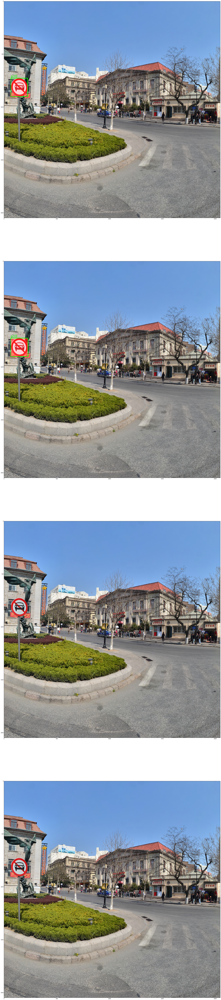

In [284]:
reload(anno_func)
imgdata = anno_func.load_img(annos, datadir, imgid)

size = 40
pl.figure(figsize=(size,size*4))
for i,anno in enumerate([annos, results_annos, sm['wrong'], sm['miss']]):
    pl.subplot(4,1,i+1)
    imgdraw = anno_func.draw_all(anno, datadir, imgid, imgdata)
    #for obj in anno['imgs'][imgid]['objects']:
    #    pl.text(obj['bbox']['xmin'], obj['bbox']['ymin'], obj['category'], fontsize=20,color='red')
    pl.imshow(imgdraw)
    
pl.savefig("/home/randon/tmp2/t.jpg")

In [235]:
pl.subplot?